# 📚 **UE: Computational Imaging**  
## 🎯 **Project: Exploring Motion Magnification**

## **reference papers :**
▶ [Learning-based motion magnification ](https://openaccess.thecvf.com/content_ECCV_2018/papers/Tae-Hyun_Oh_Learning-based_Video_Motion_ECCV_2018_paper.pdf)

▶[Phase-based motion magnification](https://people.csail.mit.edu/billf/publications/Phase-Based_Video.pdf)


## **Work done by :**
Asma Boukhdhir & Edgard Dabier




----------------------------------------------------------------------

### **Phase-based Motion magnification**




#Installing Libraries

In [ ]:
!command -v ffmpeg >/dev/null || (apt update && apt install -y ffmpeg)
!pip install -q mediapy
import mediapy as media

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 21.0 MB/s eta 0:00:00


In [ ]:
!pip install pyFFTW

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 30.4 MB/s eta 0:00:00


In [ ]:
import cv2
import numpy as np


#Utility Functions


####Converting RGB image to YIQ  and vice-versa
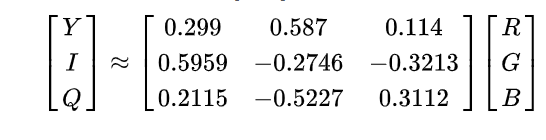



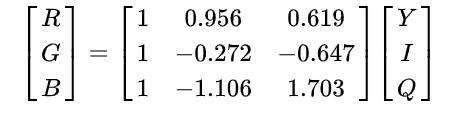

In [ ]:
from skimage import img_as_float
yiq_from_rgb = np.array([[0.299     ,0.587      ,     0.114],
                      [0.59590059,-0.27455667,-0.32134392],
                      [0.21153661, -0.52273617,0.31119955]])
rgb_from_yiq=np.linalg.inv(yiq_from_rgb)
def RGB_to_YIQ(image):
  image=img_as_float(image)         # this coverts all the values of an image to [0,1]
  image=image.dot(yiq_from_rgb.T)   #
  return image
def YIQ_to_RGB(image):
  image=img_as_float(image)
  image=image.dot(rgb_from_yiq.T)
  return image



####Reading and Writing Video File

In [ ]:
from imageio import get_reader, get_writer
def load_video(filename):
    reader = get_reader(filename)
    orig_vid = []
    for i, im in enumerate(reader):
        orig_vid.append(im)
    return np.asarray(orig_vid)
def write_video(location,result,FPS):
  media.write_video('location', result, fps=FPS)
  media.show_video(result)

#Temporal Filters

####Amplitude Weighted Blur

For each band i of the representation and each frame k , we have phase signal phi(i,k) and amplitude A(i,k) we apply  a weighted gaussian blurr


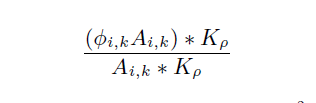

where kp is
 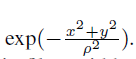

In [ ]:
from skimage.filters import gaussian
def amplitude_weighted_blur(x, weight, sigma):
    if sigma != 0:
        return gaussian(x*weight, sigma, mode="wrap") / gaussian(weight, sigma, mode="wrap")
    return x

# where x is phase of the frame ,weight is total amplitude of the frame , sigma is Standard deviation for Gaussian kernel
# The mode parameter determines how the array borders are handled

####Difference of infinite impulse response

In [ ]:
def difference_of_iir(delta, rl, rh):

    lowpass_1 = delta[0].copy()
    lowpass_2 = lowpass_1.copy()
    out = zeros(delta.shape, dtype=delta.dtype)
    for i in range(1, delta.shape[0]):
        lowpass_1 = (1-rh)*lowpass_1 + rh*delta[i]
        lowpass_2 = (1-rl)*lowpass_2 + rl*delta[i]
        out[i] = lowpass_1 - lowpass_2
    return out

#Complex Steerable Filters

####Simplify Phase and maximum pyamid height

In [ ]:
import math
from numpy import *

def simplify_phase(x):
   #Moves x into the [-pi, pi] range.
    temp= ((x + pi) % (2*pi)) - pi
    return temp

def max_scf_pyr_height(dims):
  #Gets the maximum possible steerable pyramid height
   # dims: (h, w), the height and width of  desired filters in a tuple
	return int(log2(min(dims[:2]))) - 2


In [ ]:
for i in range(-4,4,1):
  x=simplify_phase(i*pi)
  print(x)
# coverts even multiple of pi into 0 and old into -pi

0.0
-3.141592653589793
0.0
-3.141592653589793
0.0
-3.141592653589793
0.0
-3.141592653589793


####Get Filters Smooth Window
(A complex steerable filter generator with a smoother window. Better for quarter octave or half octave decompositions.)

In [ ]:
def get_polar_grid(dims):
    center = ceil((array(dims))/2).astype(int)
    xramp, yramp = meshgrid(linspace(-1, 1, dims[1]+1)[:-1], linspace(-1, 1, dims[0]+1)[:-1])
    theta = arctan2(yramp, xramp)
    r = sqrt(xramp**2 + yramp**2)

    # eliminate the zero at the center
    r[center[0], center[1]] = min((r[center[0], center[1]-1], r[center[0]-1, center[1]]))/2
    return theta,r

def get_angle_mask_smooth(index, num_bands, angle, is_complex):
    order = num_bands-1
    const = sqrt((2**(2*order))*(math.factorial(order)**2)/(num_bands*math.factorial(2*order)))
    angle = simplify_phase(angle+(pi*index/num_bands))

    if is_complex:
        return const*(cos(angle)**order)*(abs(angle) < pi/2)
    else:
        return abs(sqrt(const)*(cos(angle)**order))

def get_filters_smooth_window(dims, orientations, cos_order=6, filters_per_octave=6, is_complex=True, pyr_height=-1):
    """
    A complex steerable filter generator with a smoother window. Better for quarter octave or half octave decompositions.
    """
    max_pyr_height = max_scf_pyr_height(dims)                                   #calculating maxpyramid height that we can take from dim ie. (h,w)
    if( pyr_height == -1 or pyr_height > max_pyr_height):
        pyr_height = max_pyr_height
    total_filter_count = filters_per_octave * pyr_height                        #total fileters is (height of pyramid)*(filters per octave)

    theta, r = get_polar_grid(dims)
    r = (log2(r) + pyr_height)*pi*(0.5 + (total_filter_count / 7)) / pyr_height

    window_function = lambda x, c: (abs(x - c) < pi/2).astype(int)
    compute_shift = lambda k: pi*(k/(cos_order+1)+2/7)

    rad_filters = []

    total = zeros(dims)
    a_constant = sqrt((2**(2*cos_order))*(math.factorial(cos_order)**2)/((cos_order+1)*math.factorial(2*cos_order)))
    for k in range(total_filter_count):
        shift = compute_shift(k+1)
        rad_filters += [a_constant*(cos(r-shift)**cos_order)*window_function(r,shift)]
        total += rad_filters[k]**2
    rad_filters = rad_filters[::-1]

    center = ceil(array(dims)/2).astype(int)
    low_dims = ceil(array(center+1.5)/4).astype(int)
    total_cropped = total[center[0]-low_dims[0]:center[0]+low_dims[0]+1, center[1]-low_dims[1]:center[1]+low_dims[1]+1]

    low_pass = zeros(dims)
    low_pass[center[0]-low_dims[0]:center[0]+low_dims[0]+1, center[1]-low_dims[1]:center[1]+low_dims[1]+1] = abs(sqrt(1+0j-total_cropped))
    total += low_pass**2
    high_pass = abs(sqrt(1+0j-total))

    anglemasks = []
    for i in range(orientations):
        anglemasks += [get_angle_mask_smooth(i, orientations, theta, is_complex)]

    out = [high_pass]
    for i in range(len(rad_filters)):
        for j in range(len(anglemasks)):
            out += [anglemasks[j]*rad_filters[i]]
    out += [low_pass]
    return out

In [ ]:
(h,w)=(300,300)
filters=get_filters_smooth_window((h, w), 8, filters_per_octave=2)
len(filters)


98

####Get Filters

In [ ]:
def get_radial_mask_pair(r, rad, t_width):
    log_rad = log2(rad)-log2(r)
    hi_mask = abs(cos(log_rad.clip(min=-t_width, max=0)*pi/(2*t_width)))
    lo_mask = sqrt(1-(hi_mask**2))
    return (hi_mask, lo_mask)

def get_angle_mask(b, orientations, angle):
    order = orientations - 1
    a_constant = sqrt((2**(2*order))*(math.factorial(order)**2)/(orientations*math.factorial(2*order)))
    angle2 = simplify_phase(angle - (pi*b/orientations))
    return 2*a_constant*(cos(angle2)**order)*(abs(angle2) < pi/2)

def get_filters(dims, r_vals=None, orientations=4, t_width=1):
    """
    Gets a steerbale filter bank in the form of a list of ndarrays
    dims: (h, w). Dimensions of the output filters. Should be the same size as the image you're using these to filter
    r_vals: The boundary between adjacent filters. Should be an array.
        e.g.: 2**np.array(list(range(0,-7,-1)))
    orientations: The number of filters per level
    t-width: The falloff of each filter. Smaller t_widths correspond to thicker filters with less falloff
    """
    if r_vals is None:
        r_vals = 2**np.array(list(range(0,-max_scf_pyr_height(dims)-1,-1)))
    angle, r = get_polar_grid(dims)
    hi_mask, lo_mask_prev = get_radial_mask_pair(r_vals[0], r, t_width)
    filters = [hi_mask]
    for i in range(1, len(r_vals)):
        hi_mask, lo_mask = get_radial_mask_pair(r_vals[i], r, t_width)
        rad_mask = hi_mask * lo_mask_prev
        for j in range(orientations):
            angle_mask = get_angle_mask(j, orientations, angle)
            filters += [rad_mask*angle_mask/2]
        lo_mask_prev = lo_mask
    filters += [lo_mask_prev]
    return filters

In [ ]:
(h,w)=(300,300)
pyr_height = max_scf_pyr_height((h, w))
filters=get_filters((h, w), 2**np.array(list(range(0,-pyr_height-1,-1)), dtype=float), 4)
len(filters)


26

In [ ]:
import pyfftw.interfaces.scipy_fftpack as spfft
import skimage.transform as sktransform
temporal_filter=difference_of_iir

#Main Algorithm
Pseudo Code

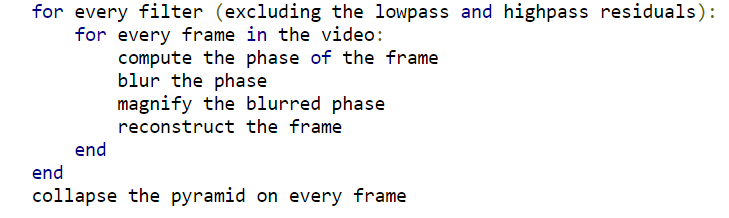

In [ ]:
def phase_amplify(video, magnification_factor, fl, fh, fs, attenuate_other_frequencies=False, pyramid_type="octave", sigma=0, temporal_filter=difference_of_iir):
    num_frames, h, w, num_channels = video.shape
    pyr_height = max_scf_pyr_height((h, w))

    if pyr_type is "octave":
        print("Using vanilla octave pyramid")
        filters = get_filters((h, w), 2**np.array(list(range(0,-pyr_height-1,-1)), dtype=float), 4)
    elif pyr_type is "halfOctave":
        print("Using half octave pyramid")
        filters = get_filters((h, w), 2**np.array(list(range(0,-pyr_height-1,-1)), dtype=float), 8, t_width=0.75)
    elif pyr_type is "smoothHalfOctave":
        print("Using smooth half octave pyramid.")
        filters = get_filters_smooth_window((h, w), 8, filters_per_octave=2)
    elif pyr_type is "quarterOctave":
        print("Using quarter octave pyramid.")
        filters = get_filters_smooth_window((h, w), 8, filters_per_octave=4)
    else:
        print("Invalid filter type. Specify ocatave, halfOcatave, smoothHalfOctave, or quarterOctave")
        return None
    yiq_video = np.zeros((num_frames, h, w, num_channels))
    fft_video = np.zeros((num_frames, h, w), dtype=complex64)

    for i in range(num_frames):
        yiq_video[i] = RGB_to_YIQ(video[i])
        fft_video[i] = spfft.fftshift(spfft.fft2(yiq_video[i][:,:,0]))

    magnified_y_channel = np.zeros((num_frames, h, w), dtype=complex64)
    dc_frame_index = 0
    for i in range(1,len(filters)-1):
        print("processing level "+str(i))

        dc_frame = spfft.ifft2(spfft.ifftshift(filters[i]*fft_video[dc_frame_index]))
        dc_frame_no_mag = dc_frame / np.abs(dc_frame)
        dc_frame_phase = np.angle(dc_frame)

        total = np.zeros(fft_video.shape, dtype=float)
        filtered = np.zeros(fft_video.shape, dtype=complex64)

        for j in range(num_frames):
            filtered[j] = spfft.ifft2(spfft.ifftshift(filters[i]*fft_video[j]))
            total[j] = simplify_phase(np.angle(filtered[j]) - dc_frame_phase)

        print("bandpassing...")
        total = temporal_filter(total, fl/fs, fh/fs).astype(float)

        for j in range(num_frames):
            phase_of_frame = total[j]
            if sigma != 0:
                phase_of_frame = amplitude_weighted_blur(phase_of_frame, np.abs(filtered[j]), sigma)

            phase_of_frame *= magnification_factor

            if attenuate_other_frequencies:
                temp_orig = np.abs(filtered[j])*dc_frame_no_mag
            else:
                temp_orig = filtered[j]
            magnified_component = 2*filters[i]*spfft.fftshift(spfft.fft2(temp_orig*np.exp(1j*phase_of_frame)))

            magnified_y_channel[j] = magnified_y_channel[j] + magnified_component

    for i in range(num_frames):
            magnified_y_channel[i] = magnified_y_channel[i] + (fft_video[i]*(filters[-1]**2))

    out = np.zeros(yiq_video.shape)

    for i in range(num_frames):
        out_frame  = np.dstack((np.real(spfft.ifft2(spfft.ifftshift(magnified_y_channel[i]))), yiq_video[i,:,:,1:3]))
        out[i] = YIQ_to_RGB(out_frame)

    return out.clip(min=0, max=1)

<>:5: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:8: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:11: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:14: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:5: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:8: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:11: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:14: SyntaxWarning: "is" with a literal. Did you mean "=="?
<ipython-input-34-cb9a0e03bb52>:5: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if pyr_type is "octave":
<ipython-input-34-cb9a0e03bb52>:8: SyntaxWarning: "is" with a literal. Did you mean "=="?
  elif pyr_type is "halfOctave":
<ipython-input-34-cb9a0e03bb52>:11: SyntaxWarning: "is" with a literal. Did you mean "=="?
  elif pyr_type is "smoothHalfOctave":
<ipython-input-34-cb9a0e03bb52>:14: SyntaxWarning: "is" with a literal. Did you mean "=="?
  elif pyr_type is "quarterOctave":


#Input and Pre-Processing

In [ ]:
video_file = "/content/guitar.avi"
video = load_video(video_file)

video_resized = np.zeros((len(video), 250, 250, 3))
for i in range(len(video)):
    video_resized[i] = sktransform.resize(video[i], (250,250))

#Parameters and Results

In [ ]:
magnification_factor = 20
fl = 0.5
fh = 7.5
fs = 30
attenuate_other_frequencies=True
pyr_type = "halfOctave"
sigma = 5
temporal_filter = difference_of_iir
scale_video = .8

In [ ]:
guitar_phase_20 =phase_amplify(video_resized, magnification_factor, fl, fh, fs, attenuate_other_frequencies=attenuate_other_frequencies, pyramid_type=pyr_type, sigma=sigma, temporal_filter=temporal_filter)

Using half octave pyramid
processing level 1
bandpassing...
processing level 2
bandpassing...
processing level 3
bandpassing...
processing level 4
bandpassing...
processing level 5
bandpassing...
processing level 6
bandpassing...
processing level 7
bandpassing...
processing level 8
bandpassing...
processing level 9
bandpassing...
processing level 10
bandpassing...
processing level 11
bandpassing...
processing level 12
bandpassing...
processing level 13
bandpassing...
processing level 14
bandpassing...
processing level 15
bandpassing...
processing level 16
bandpassing...
processing level 17
bandpassing...
processing level 18
bandpassing...
processing level 19
bandpassing...
processing level 20
bandpassing...
processing level 21
bandpassing...
processing level 22
bandpassing...
processing level 23
bandpassing...
processing level 24
bandpassing...
processing level 25
bandpassing...
processing level 26
bandpassing...
processing level 27
bandpassing...
processing level 28
bandpassing...
pro

In [ ]:
guitar_phase_10 = phase_amplify(video_resized, 10, fl, fh, fs, attenuate_other_frequencies=attenuate_other_frequencies, pyramid_type=pyr_type, sigma=sigma, temporal_filter=temporal_filter)

Using half octave pyramid
processing level 1
bandpassing...
processing level 2
bandpassing...
processing level 3
bandpassing...
processing level 4
bandpassing...
processing level 5
bandpassing...
processing level 6
bandpassing...
processing level 7
bandpassing...
processing level 8
bandpassing...
processing level 9
bandpassing...
processing level 10
bandpassing...
processing level 11
bandpassing...
processing level 12
bandpassing...
processing level 13
bandpassing...
processing level 14
bandpassing...
processing level 15
bandpassing...
processing level 16
bandpassing...
processing level 17
bandpassing...
processing level 18
bandpassing...
processing level 19
bandpassing...
processing level 20
bandpassing...
processing level 21
bandpassing...
processing level 22
bandpassing...
processing level 23
bandpassing...
processing level 24
bandpassing...
processing level 25
bandpassing...
processing level 26
bandpassing...
processing level 27
bandpassing...
processing level 28
bandpassing...
pro

In [ ]:
guitar_phase_50 =phase_amplify(video_resized, 50, fl, fh, fs, attenuate_other_frequencies=attenuate_other_frequencies, pyramid_type=pyr_type, sigma=sigma, temporal_filter=temporal_filter)

Using half octave pyramid
processing level 1
bandpassing...
processing level 2
bandpassing...
processing level 3
bandpassing...
processing level 4
bandpassing...
processing level 5
bandpassing...
processing level 6
bandpassing...
processing level 7
bandpassing...
processing level 8
bandpassing...
processing level 9
bandpassing...
processing level 10
bandpassing...
processing level 11
bandpassing...
processing level 12
bandpassing...
processing level 13
bandpassing...
processing level 14
bandpassing...
processing level 15
bandpassing...
processing level 16
bandpassing...
processing level 17
bandpassing...
processing level 18
bandpassing...
processing level 19
bandpassing...
processing level 20
bandpassing...
processing level 21
bandpassing...
processing level 22
bandpassing...
processing level 23
bandpassing...
processing level 24
bandpassing...
processing level 25
bandpassing...
processing level 26
bandpassing...
processing level 27
bandpassing...
processing level 28
bandpassing...
pro

In [ ]:
guitar_phase_100 =phase_amplify(video_resized, 100, fl, fh, fs, attenuate_other_frequencies=attenuate_other_frequencies, pyramid_type=pyr_type, sigma=sigma, temporal_filter=temporal_filter)

Using half octave pyramid
processing level 1
bandpassing...
processing level 2
bandpassing...
processing level 3
bandpassing...
processing level 4
bandpassing...
processing level 5
bandpassing...
processing level 6
bandpassing...
processing level 7
bandpassing...
processing level 8
bandpassing...
processing level 9
bandpassing...
processing level 10
bandpassing...
processing level 11
bandpassing...
processing level 12
bandpassing...
processing level 13
bandpassing...
processing level 14
bandpassing...
processing level 15
bandpassing...
processing level 16
bandpassing...
processing level 17
bandpassing...
processing level 18
bandpassing...
processing level 19
bandpassing...
processing level 20
bandpassing...
processing level 21
bandpassing...
processing level 22
bandpassing...
processing level 23
bandpassing...
processing level 24
bandpassing...
processing level 25
bandpassing...
processing level 26
bandpassing...
processing level 27
bandpassing...
processing level 28
bandpassing...
pro

original_video,result

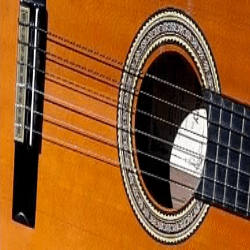
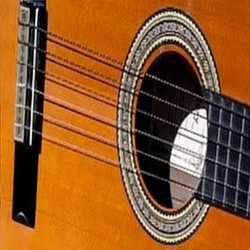

In [ ]:
FPS = 30
import mediapy
video_dict = {'original_video':video_resized,'result':guitar_phase_10}
mediapy.show_videos(video_dict, fps=FPS, width=250, codec='gif')


In [ ]:
np.save("guitare_10.npy", result)

# **Evaluation**

In [ ]:
import random as r
import matplotlib.pyplot as plt
import numpy as np
import cv2

In [ ]:
pip install opencv-python piq

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.9/106.9 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 79.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 63.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 19.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 757.0 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 69.2 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

### **SSIM (structural similarity index measure)**

In [ ]:
from skimage.metrics import structural_similarity as ssim

def compute_ssim(img1, img2):
    return ssim(img1, img2, data_range=img2.max() - img2.min())

In [ ]:
def compute_video_ssim(video1, video2):
    ssim_values = []
    video1 = (video1 * 255).clip(0, 255).astype(np.uint8)
    video2 = (video2 * 255).clip(0, 255).astype(np.uint8)

    if len(video1) == 0 or len(video2) == 0:
        raise ValueError("Les vidéos ne contiennent aucun frame !")

    for i in range(len(video1) - 1):

        frame1 = video1[i].astype(np.uint8)
        frame2 = video2[i].astype(np.uint8)
        frame1_gray = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)
        frame2_gray = cv2.cvtColor(frame2, cv2.COLOR_BGR2GRAY)

        ssim_value = compute_ssim(frame1_gray, frame2_gray)

        ssim_values.append(ssim_value)

    if not ssim_values:  # Vérifier si la liste est vide
        return 0  # Ou une autre valeur par défaut

    return np.mean(ssim_values)



In [ ]:
video1 = guitar_phase_100
video2 = video_resized
print(compute_video_ssim(video1, video2))

0.5616035720003408


### **BRISQUE(Blind/Referenceless Image Spatial Quality Evaluator) metric**

In [ ]:
from piq import brisque
import torch

In [ ]:
def calculate_brisque(video):
  scores = []
  for i in range(len(video)):
        frame = video[i]
        frame = (frame * 255).astype(np.uint8)
        # Convert frame to tensor [H, W, C] -> [1, C, H, W]
        frame_tensor = torch.tensor(frame, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0) # Change here. permute changes the order of dimensions from H,W,C to C,H,W. Unsqueeze adds an extra dimension at the beginning for batch size making it 1,C,H,W which is the 4 dimensions needed.
        score = brisque(frame_tensor, data_range=255.0).item()
        scores.append(score)
  return np.mean(scores), np.std(scores)  # Return mean and std deviation


In [ ]:
print(calculate_brisque(guitar_phase_10))
print(calculate_brisque(guitar_phase_20))
print(calculate_brisque(guitar_phase_50))
print(calculate_brisque(guitar_phase_100))

(np.float64(33.83364283784907), np.float64(0.7667452538843996))
(np.float64(33.83364283784907), np.float64(0.7667452538843996))
(np.float64(32.30283263727283), np.float64(1.2734016023631365))
(np.float64(33.121060418744456), np.float64(1.8484640544895548))


### **Power spectral density using Welch's method**

In [ ]:
from scipy.signal import welch

In [ ]:
def compute_psd(video, fs):
    if video.max() <= 1.0:  # Check if images are normalized (0-1)
      video = (video * 255).clip(0, 255).astype(np.uint8)
    gray_frame = cv2.cvtColor(video[0], cv2.COLOR_BGR2GRAY)
    height, width = gray_frame.shape

    # Initialize an array to hold the temporal pixel intensity variations
    pixel_time_series = []
    # Read frames and extract the mean intensity
    for i in range(len(video)):
        gray_frame = cv2.cvtColor(video[i], cv2.COLOR_BGR2GRAY)
        mean_intensity = np.mean(gray_frame)
        pixel_time_series.append(mean_intensity)
    # Convert list to numpy array
    pixel_time_series = np.array(pixel_time_series)
    # Compute the Power Spectral Density using Welch's method
    frequencies, psd = welch(pixel_time_series, fs=fs, nperseg=1024)

    return frequencies, psd

def plot_psd(frequencies, psd, label):
    plt.semilogy(frequencies, psd, label=label)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power Spectral Density')
    plt.title('Power Spectral Density of Video')
    plt.legend()
    plt.grid()
    plt.show()


In [ ]:
sampling_rate = 30

# Compute PSD for both videos
frequencies_1, psd_1 = compute_psd(video, sampling_rate)
# frequencies_2, psd_2 = compute_psd(video, sampling_rate)
# Plot the PSDs for comparison
plot_psd(frequencies_1, psd_1, label='Motion Magnification Method 1')
# plot_psd(frequencies_2, psd_2, label='Motion Magnification Method 2')

In [ ]:
sampling_rate = 30
frequencies , psd = compute_psd(video, sampling_rate)
frequencies_10, psd_10 = compute_psd(guitar_phase_10, sampling_rate)
frequencies_20, psd_20 = compute_psd(guitar_phase_20, sampling_rate)
frequencies_50, psd_50 = compute_psd(guitar_phase_50, sampling_rate)
frequencies_100, psd_100 = compute_psd(guitar_phase_100, sampling_rate)

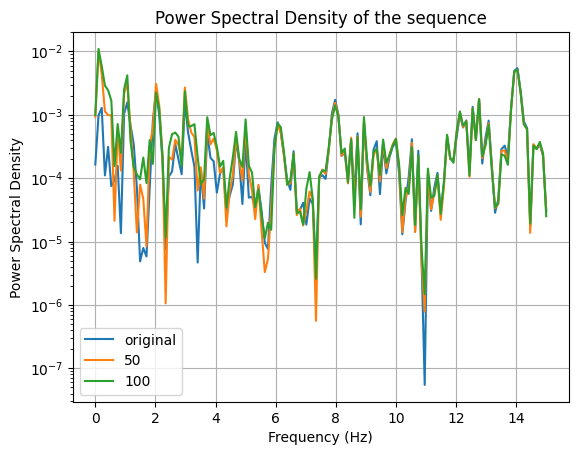

In [ ]:
plt.semilogy(frequencies, psd, label='original')
# plt.semilogy(frequencies_10, psd_10, label='10')
# plt.semilogy(frequencies_20, psd_20, label='20')
plt.semilogy(frequencies_50, psd_50, label='50')
plt.semilogy(frequencies_100, psd_100, label='100')

plt.xlabel('Frequency (Hz)')
plt.ylabel('Power Spectral Density')
plt.title('Power Spectral Density of the sequence')
plt.legend()
plt.grid()
plt.show()

### **Motion consistency using optical flow comparison**

In [ ]:
def calcul_optical_flow(frame1,frame2):
    # Ensure images are in range [0,255] and of type uint8
    if frame1.max() <= 1.0:  # Check if images are normalized (0-1)
        frame1 = (frame1 * 255).astype(np.uint8)
        frame2 = (frame2 * 255).astype(np.uint8)
    else:
        frame1 = frame1.astype(np.uint8)
        frame2 = frame2.astype(np.uint8)

    # Convert frames to grayscale (Make sure they are BGR if needed)
    frame1_gray = cv2.cvtColor(frame1, cv2.COLOR_RGB2GRAY)  # Use COLOR_RGB2GRAY if images are in RGB
    frame2_gray = cv2.cvtColor(frame2, cv2.COLOR_RGB2GRAY)


    # Compute Optical Flow
    flow =  flow = cv2.calcOpticalFlowFarneback(frame1_gray, frame2_gray, None, pyr_scale=0.5, levels=3, winsize=15, iterations=3, poly_n=5, poly_sigma=1.2, flags=0)
    return flow

def compute_motion_consistency(video1,video2):
    correlation_coeffs = []

    for i in range(1,len(video1)):
        orig_gray,mag_gray = video1[i],video2[i]
        prev_orig_gray,prev_mag_gray = video1[i-1],video2[i-1]
        # Calculate optical flow between consecutive frames
        flow_orig =  calcul_optical_flow(prev_orig_gray, orig_gray)
        flow_mag =  calcul_optical_flow(prev_mag_gray, mag_gray)

        # Flatten the flow fields
        flow_orig_flat = flow_orig.reshape(-1, 2)
        flow_mag_flat = flow_mag.reshape(-1, 2)

        # Compute the correlation coefficient between the flow fields
        correlation_matrix = np.corrcoef(flow_orig_flat[:, 0], flow_mag_flat[:, 0])
        correlation_x = correlation_matrix[0, 1]

        correlation_matrix = np.corrcoef(flow_orig_flat[:, 1], flow_mag_flat[:, 1])
        correlation_y = correlation_matrix[0, 1]

        # Average correlation for x and y components
        avg_correlation = (correlation_x + correlation_y) / 2
        correlation_coeffs.append(avg_correlation)
        print(i)

    # Compute the overall Motion Consistency Index
    motion_consistency_index = np.mean(correlation_coeffs)
    return motion_consistency_index

mci = compute_motion_consistency(video_resized,guitar_phase_10)
print(f'Motion Consistency Index: {mci}')

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
